 # Training a crop growth model to SAR data
 Developed by Agrimetrics, 10th July 2020

 Crop growth models are much sought after in agri-food systems to enable crop properties
 such as yields, carbon fluxes, crop quality and harvest timings to be forecasted accurately.
 A major challenge in creating such models is obtaining adequate data to allow them to be developed and trained.
 Here we show how satellite derived radar data (Synthetic Aperture Radar: SAR) could be used
 as a proxy for training data to enable the development of accurate crop growth models, reducing
 the need for in-field measured data. The ultimate result of this is the production of a
 crop-growth model that can be used to forecast and predict crop growth at different locations.

 This walkthrough illustrates a few key points
 1) How SAR data could be used as one of the sources of training data for crop growth models.
 2) How such data can be obtained alongside other data directly from the Agrimetrics Data Marketplace
 in order to drive such growth models - we use the Agrimetrics GraphQL API to fetch the data.
 3) How such data can be combined with mechanistic crop growth models via Bayesian parameter estimation
 to generate models that can make probabilistic forecasts of crop development. Baysian inference is
 performed with pymc3 (3.8) and theano (1.0.4).

 Some important caveats
 1) The crop growth model is just about the simplest we could think of and is intended for illustrative
 purposes. Finding the best crop growth models for real crops is a much more involved process.
 2) We exclusively use SAR as the model training data, although we typically use a wider range of training datasets,
 including ground truth data whenever possible.
 3) The model is only driven by temperature and in a very simple way. We typically adopt more driver datasets and in
 a more sophisticated way when drivign crop growth models.

 Key References
 1) PyMC3 | https://docs.pymc.io/ |: Salvatier J., Wiecki T.V., Fonnesbeck C. (2016) Probabilistic programming in Python using PyMC3. PeerJ Computer Science 2:e55 DOI: 10.7717/peerj-cs.55.
 2) Theano | http://www.deeplearning.net/software/theano/citation.html | Theano Development Team. “Theano: A Python framework for fast computation of mathematical expressions”.
 3) Caldararu, S., Purves, D.W. and Smith, M.J., 2017. The impacts of data constraints on the predictive performance of a general process-based crop model (PeakN-crop v1. 0). Geoscientific Model Development, 10(4), pp.1679-1701.

 ## Imports
 Some code libraries that we need.

In [1]:
import os
import pickle

import requests

import numpy as np
import pandas as pd
import pymc3 as pm
import theano.tensor as tt
import matplotlib.pyplot as plt

from scipy.integrate import odeint
from theano.compile.ops import as_op


 ## Obtaining data through the GraphQL API
 We first set up some functions to help us to query the Agrimetrics GraphQL API
 to obtain SAR and Temperature data for a chosen location. One function finds the
 Agrimetrics field ID associated with a chosen location. The others then obtain
 SAR and temperature data for that identified field.

In [2]:
# We first need you to input your API key - you can get this from your Agrimetrics subscription.
API_KEY = os.environ.get('API_KEY') or input("Query API Subscription Key: ").strip()


In [3]:
# The below function then retrieves the response from GraphQL for a query that gets passed to it.
GRAPHQL_ENDPOINT = "https://api.agrimetrics.co.uk/graphql/v1/"
headers = { 'Ocp-Apim-Subscription-Key': API_KEY, 'Content-Type': 'application/json', 'Accept-Encoding': 'gzip, deflate, br' }

def graphql(query, **variables):
    response = requests.post(GRAPHQL_ENDPOINT, headers=headers, json={'query': query, 'variables': variables})
    response.raise_for_status()
    results = response.json()
    errors = results.get('errors')
    if not errors:
        return results['data']
    raise Exception(f'GraphQL query errors: {errors}')


 ## GraphQL queries
 Below are defined 3 GraphQL query functions:
 - get_field_id retrieves the Agrimetrics field identifier at a given location.
 - get_daily_mean_temperatures retrieves daily mean temperatures for a given field identifer.
 - get_sar to retrieves SAR data for a given field identifier.

In [4]:
def get_field_id(point):
    field_id_query = '''
        query getField($point: CoordinateScalar!) {
            fields(geoFilter: {location: {type: Point, coordinates: $point}}) {
                id
            }
        }'''
    return graphql(field_id_query, point=point)['fields'][0]['id']

def get_daily_mean_temperatures(field_id, start_date, end_date):
    weather_query = '''
        query getWeather($field_id: [ID!]!, $start_date:Date!, $end_date:Date!, $cursor: String) {
            fields(where: {id: {EQ: $field_id}}) {
                weatherObservations(dateRange: {startDate: $start_date endDate: $end_date}, after: $cursor) {
                    cursor
                    temperatureMeanDaily {
                        value
                        dateTime
                    }
                }
            }
        }'''
    cursor = ''
    weather_data = []
    while cursor is not None:
        results = graphql(weather_query, field_id=field_id, start_date=start_date, end_date=end_date, cursor=cursor)
        cursor = results['fields'][0]['weatherObservations']['cursor']
        for weather_observation in results['fields'][0]['weatherObservations']['temperatureMeanDaily']:
            weather_data.append({
                'weather_variable': 'temperatureMeanDaily', 
                'dateTime': weather_observation['dateTime'], 
                'value': weather_observation['value']
            })

    weather_data = pd.DataFrame(weather_data).pivot(index='dateTime', columns='weather_variable', values='value')
    weather_data.reset_index(inplace=True)
    weather_data.loc[:, 'dateTime'] = pd.to_datetime(weather_data['dateTime'])
    weather_data.loc[:, 'date'] = pd.to_datetime(weather_data['dateTime'].dt.date)
    weather_data.drop(columns=['dateTime'], inplace=True)
    return weather_data

def get_sar(field_id, start_date, end_date, relative_orbit_number):
    sar_query = '''
        query getSar($field_id: [ID!]!, $start_date:DateTime!, $end_date:DateTime!) {
            fields(where: {id: {EQ: $field_id}}) {
                sarObservations(where: {dateTime: {GE: $start_date, LE: $end_date}}) {
                    dateTime
                    relativeOrbitNumber
                    gamma0Observation {
                        polarisationVH {
                            mean
                        }
                        polarisationVV {
                            mean
                        }
                    }
                }
            }
        }'''
    results = graphql(sar_query, field_id=field_id, start_date=f'{start_date}T00:00:00.000Z', end_date=f'{end_date}T00:00:00.000Z')
    sar_data = []
    for sar_observation in results['fields'][0]['sarObservations']:
        if relative_orbit_number != sar_observation['relativeOrbitNumber']:
            continue
        sar_data.append({
            'sar_variable': 'Gamma0-VH-mean', 
            'dateTime': sar_observation['dateTime'], 
            'value': sar_observation['gamma0Observation']['polarisationVH']['mean']
        })

        sar_data.append({
            'sar_variable': 'Gamma0-VV-mean', 
            'dateTime': sar_observation['dateTime'], 
            'value': sar_observation['gamma0Observation']['polarisationVV']['mean']
        })

    sar_data = pd.DataFrame(sar_data).pivot(index='dateTime', columns='sar_variable', values='value')
    sar_data.reset_index(inplace=True)
    sar_data.loc[:, 'dateTime'] = pd.to_datetime(sar_data['dateTime'])
    sar_data.loc[:, 'date'] = pd.to_datetime(sar_data['dateTime'].dt.date)
    sar_data.drop(columns=['dateTime'], inplace=True)
    return sar_data


 ## Retrieve data for a field in University of Reading farm
 These data are freely available for Agrimetrics subscribers.

In [5]:
reading_point = [-0.919033248, 51.406798039] # growing wheat in 2017-18
reading_field_id = get_field_id(reading_point)
reading_weather = get_daily_mean_temperatures(reading_field_id, '2018-01-01', '2018-08-31')
reading_sar = get_sar(reading_field_id, '2018-01-01', '2018-08-31', '132')


 ## Plot temperature and SAR time series for University of Reading farm

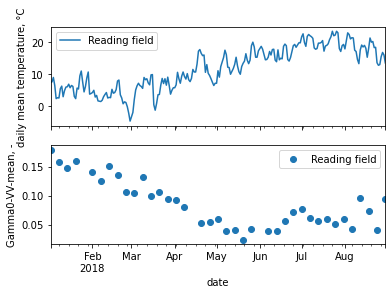

In [6]:
fig, (ax1, ax2) = plt.subplots(nrows=2, sharex=True)
ax1.set_ylabel('daily mean temperature, °C')
reading_weather.plot(ax=ax1, x='date', y='temperatureMeanDaily', c='C0', label='Reading field')
ax2.set_ylabel('Gamma0-VV-mean, -')
reading_sar.plot(ax=ax2, x='date', y='Gamma0-VV-mean', c='C0', label='Reading field', style='o')



 ## Define simple growth rate model
 We next define a simple model that predicts the relationship between the
 crop biomass growth rate and temperature.
 The models is
 dW/dt = aT - bW,
 where W is crop biomass (tonnes/ha), a is the biomass fixation rate (tonnes/ha/day/°C),
 b is the biomass specific loss rate (1/day) and T is daily temperature in °C.
 a and b are both positive, a>b and initial plant biomass is W0.

In [7]:
def growth_rate(w, t, temps, a, b):
    day = min(len(temps)-1, int(t))
    return max(0, a*temps[day] - b*w)


 ## Define some initial representative parameters
 We wish to assume sensible values for the crop growth parameters so that they can create
 reasonable timeseries of crop growth. To do that we make some initial assumptions
 on average yield, harvest index, sowing density and seed weight.

In [8]:
  
# We first work out a sensible final crop biomass.
final_biomass = 8.5/0.45 # 8.5 t/ha average yield, 0.45 harvest index.

# We choose an arbitrary value for b and then use that and final biomass to work out an expected value for a
b = 7E-3
a = b * final_biomass/reading_weather['temperatureMeanDaily'].mean()

# W0 is worked out using seed sowing rate and grain weight
w0 = 300*0.045*1E4/1E6 # t/ha seed rate at 300 seeds/m² and thousand grain weight at 45 g

print(f'a: {a} (t/ha/day/°C), b: {b} (1/day), w0: {w0} (t/ha)')


a: 0.0112417340191036 (t/ha/day/°C), b: 0.007 (1/day), w0: 0.135 (t/ha)


 ## Solve equation for crop biomass over time and show example
 The growth rate is easily integrated to calculate daily plant biomass:

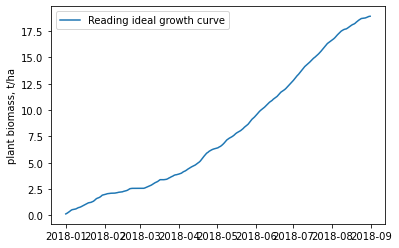

In [9]:
def ideal_growth(temperatures):
    days = np.arange(len(temperatures))
    return odeint(growth_rate, t=days, y0=[w0], args=(temperatures, a, b))

reading_w = ideal_growth(reading_weather['temperatureMeanDaily'].values)

plt.ylabel('plant biomass, t/ha')
plt.plot(reading_weather['date'], reading_w, c='C0', label='Reading ideal growth curve')
plt.legend()


 ## Plant biomass-SAR relationship
 We want to infer the values of a, b and w0 using SAR timeseries.
 For this, we need to define a relationship between plant biomass and SAR reflectance.
 In this example we just pick a sensible simple relationship.
 We note that SAR reflectance decreases from March to June while plant biomass increases
 over that time period. We therefore propose the simple relashionship:
 VV = s/W, where VV is the mean Gamma0 VV over the field (dimensionless) and s is a scaling coefficient (ha/t).

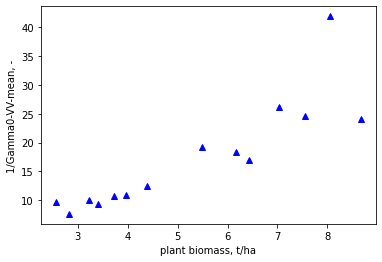

In [10]:
days_between_mar_may = reading_weather['date'].dt.month.isin(range(3, 6))
days_with_sar = reading_weather['date'].isin(reading_sar['date'])
days_with_sar_sensitivity = (days_between_mar_may & days_with_sar).values

sar_between_mar_may = reading_sar['date'].dt.month.isin(range(3, 6)).values

plt.xlabel('plant biomass, t/ha')
plt.ylabel('1/Gamma0-VV-mean, -')
plt.plot(reading_w[days_with_sar_sensitivity], 1/reading_sar.loc[sar_between_mar_may, 'Gamma0-VV-mean'], 'b^')


 ## Define model for parameter inference
 We use the Bayesian parameter inference package PYMC3 to infer the parameters.
 The differential equation integration is implemented as a theano operator.
 In order to ensure that a > b, we define a* = a - b.
 We model A*, B, W0 and S as the parameter distributions of a*, b, w0 and s, respectively.

In [11]:
growth_model = pm.Model()

temperatures = reading_weather['temperatureMeanDaily'].values
vv_obs = reading_sar.loc[sar_between_mar_may, 'Gamma0-VV-mean'].values.reshape(sar_between_mar_may.sum(), 1)

with growth_model:
    @as_op(itypes=[tt.dscalar, tt.dscalar, tt.dscalar], otypes=[tt.dmatrix])
    def th_odeint(w0, a_star, b):
        a = b + a_star
        simulated_days = np.arange(len(temperatures))
        return odeint(growth_rate, t=simulated_days, y0=[w0], args=(temperatures, a, b))
    
    W0 = pm.Lognormal('W0', mu=np.log(w0), sigma=0.5)
    A_star = pm.Lognormal('A*', mu=np.log(a - b), sigma=0.5)
    B = pm.Lognormal('B', mu=np.log(b), sigma=0.5)

    W = pm.Deterministic('W', th_odeint(W0, A_star, B))

    S = pm.Lognormal('S', mu=np.log(0.5), sigma=0.5)
    VV = pm.Deterministic('VV', S / W)

    sigma_VV = pm.Lognormal('sigma-VV')
    VV_obs = pm.Lognormal('VV_obs', mu=pm.math.log(VV[days_with_sar_sensitivity]), sigma=sigma_VV, observed=vv_obs)


 ## Run parameter inference
 We use pymc3 to infer the parameter distributions for w0, a*, b, and s.
 The process takes around 2 hours. A pickled trace can be loaded using the last cell of this notebook.

In [12]:
with growth_model:
    trace = pm.sample(500, chains=4, tune=1500, cores=4, random_seed=57468)


Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Initializing NUTS failed. Falling back to elementwise auto-assignment.
Multiprocess sampling (4 chains in 4 jobs)
CompoundStep
>CompoundStep
>>Slice: [B]
>>Slice: [A*]
>>Slice: [W0]
>NUTS: [sigma-VV, S]
Sampling 4 chains, 11 divergences: 100%|██████████| 8000/8000 [2:38:31<00:00,  1.19s/draws]
There were 5 divergences after tuning. Increase `target_accept` or reparameterize.
The acceptance probability does not match the target. It is 0.5010200793302436, but should be close to 0.8. Try to increase the number of tuning steps.
There were 3 divergences after tuning. Increase `target_accept` or reparameterize.
The acceptance probability does not match the target. It is 0.6877564423157279, but should be close to 0.8. Try to increase the number of tuning steps.
There were 3 divergences after tuning. Increase `target_accept` or reparameterize.
The acceptance probability does not match the target. It is 0.53788928288724

 ### Trace plots
 The trace plots show the infered parameter distributions.

array([[<matplotlib.axes._subplots.AxesSubplot object at 0x7f61b81c1e20>,
      dtype=object)

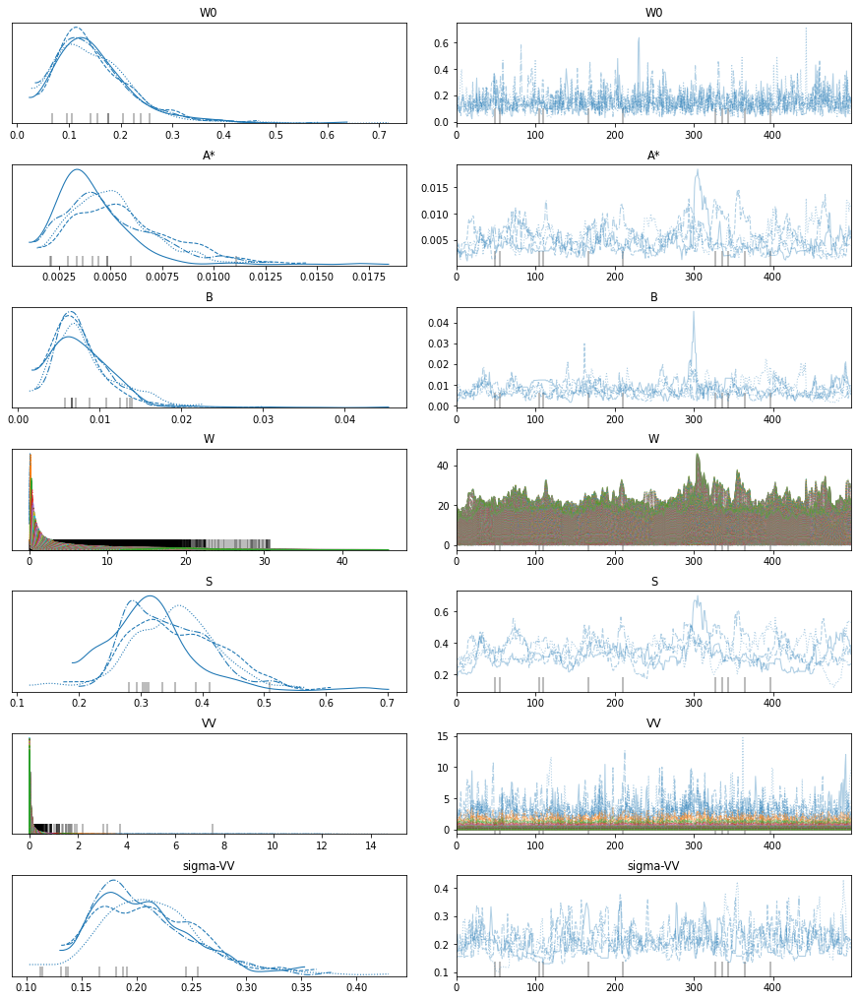

In [13]:
pm.traceplot(trace)


 ### Predicting plant biomass
 Using infered parameters, we now simulate daily plant growth and the corresponding VV timeseries.

In [14]:
with growth_model:
    VV_obs_daily = pm.Lognormal('VV_obs_daily', mu=pm.math.log(VV), sigma=sigma_VV, shape=(len(temperatures), 1))
    posterior_predictive = pm.sample_posterior_predictive(trace, var_names=['W', 'VV_obs_daily'], random_seed=16954)



100%|██████████| 2000/2000 [07:24<00:00,  4.49it/s]


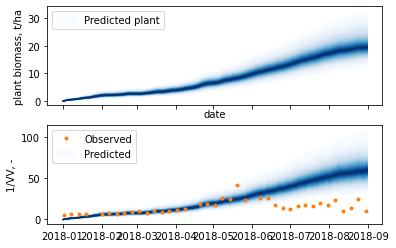

In [15]:
reading_W_pred = posterior_predictive['W']
reading_W_pred = reading_W_pred.reshape(reading_W_pred.shape[0:2])
reading_VV_pred = posterior_predictive['VV_obs_daily']
reading_VV_pred = reading_VV_pred.reshape(reading_VV_pred.shape[0:2])

fig, (ax1, ax2) = plt.subplots(nrows=2, sharex=True)
ax1.set_xlabel('date')
ax1.set_ylabel('plant biomass, t/ha')
pm.gp.util.plot_gp_dist(ax1, reading_W_pred, reading_weather['date'].values, plot_samples=False, palette="Blues")
ax1.legend(['Predicted plant'], loc='upper left')

ax2.set_ylabel('1/VV, -')
pm.gp.util.plot_gp_dist(ax2, 1/reading_VV_pred, reading_weather['date'].values, plot_samples=False, palette="Blues")
ax2.plot(reading_sar['date'], 1/reading_sar['Gamma0-VV-mean'], 'k.', c='C1')
ax2.legend(['Observed', 'Predicted'], loc='upper left')


 ## Predicting crop growth for another field using the trained model
 Note that in this case the model is ONLY driven using the temperature data
 We first retrieve an Agrimetrics field id for a new location
 and then the associated daily mean temperatures and SAR observations.

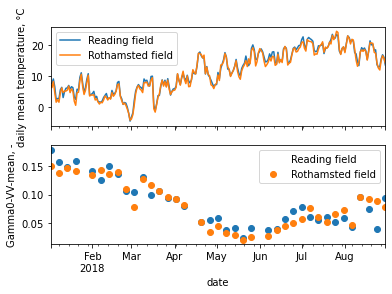

In [16]:
rothamsted_point = [-0.379304159, 51.815101958] # this is a field in Rothamsted farm growing wheat in 2017-18
rothamsted_field_id = get_field_id(rothamsted_point)
rothamsted_weather = get_daily_mean_temperatures(rothamsted_field_id, '2018-01-01', '2018-08-31')
rothamsted_sar = get_sar(rothamsted_field_id, '2018-01-01', '2018-08-31', '132')


fig, (ax1, ax2) = plt.subplots(nrows=2, sharex=True)
ax1.set_ylabel('daily mean temperature, °C')
reading_weather.plot(ax=ax1, x='date', y='temperatureMeanDaily', c='C0', label='Reading field')
rothamsted_weather.plot(ax=ax1, x='date', y='temperatureMeanDaily', c='C1', label='Rothamsted field')
ax2.set_ylabel('Gamma0-VV-mean, -')
reading_sar.plot(ax=ax2, x='date', y='Gamma0-VV-mean', c='C0', label='Reading field', style='o')
rothamsted_sar.plot(ax=ax2, x='date', y='Gamma0-VV-mean', c='C1', label='Rothamsted field', style='o')


 Then we change the temperatures and sample the predictions using the pre-trained model:

In [17]:
temperatures = rothamsted_weather['temperatureMeanDaily'].values
with growth_model:
    posterior_predictive_roth = pm.sample_posterior_predictive(trace, var_names=['W', 'VV_obs_daily'], random_seed=6841)


100%|██████████| 2000/2000 [07:33<00:00,  4.41it/s]


 ## View preditions for the site in Rothamsted

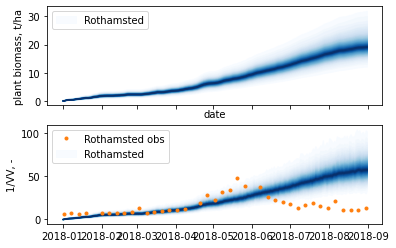

In [18]:
rothamsted_W_pred = posterior_predictive_roth['W']
rothamsted_W_pred = rothamsted_W_pred.reshape(rothamsted_W_pred.shape[0:2])
rothamsted_VV_pred = posterior_predictive_roth['VV_obs_daily']
rothamsted_VV_pred = rothamsted_VV_pred.reshape(rothamsted_VV_pred.shape[0:2])

fig, (ax1, ax2) = plt.subplots(nrows=2, sharex=True)
ax1.set_xlabel('date')
ax1.set_ylabel('plant biomass, t/ha')
pm.gp.util.plot_gp_dist(ax1, rothamsted_W_pred, rothamsted_weather['date'].values, plot_samples=False, palette="Blues")
ax1.legend(['Rothamsted'], loc='upper left')

ax2.set_ylabel('1/VV, -')
pm.gp.util.plot_gp_dist(ax2, 1/rothamsted_VV_pred, rothamsted_weather['date'].values, plot_samples=False, palette="Blues")
ax2.plot(rothamsted_sar['date'], 1/rothamsted_sar['Gamma0-VV-mean'], 'k.', c='C1')
ax2.legend(['Rothamsted obs', 'Rothamsted'], loc='upper left')


In [19]:
# save trace to pickle file
with open('trace.pkl', 'wb') as f:
    pickle.dump(trace, f)


In [ ]:
# load trace from pickle file
with open('trace.pkl', 'rb') as f:
    trace = pickle.load(f)